In [11]:
from ont_fast5_api.fast5_interface import get_fast5_file
import h5py
import matplotlib.pyplot as plt
import numpy as np
import pysam 

In [12]:
PATH = "/media/xjtu/7A68EF0368EEBCCF/Q20_ULK_Cliveome/ONLA29095_6/20210331_1614_5B_PAG53448_b1401eb9/fast5_pass"

In [13]:
def print_all_raw_data():
    fast5_filepath = f"{PATH}/PAG53448_pass_ced55105_0.fast5" # This can be a single- or multi-read file
    with get_fast5_file(fast5_filepath, mode="r") as f5:
        for read in f5.get_reads():
            raw_data = read.get_raw_data()
            print(read.read_id, raw_data)

In [14]:
# print_all_raw_data()

In [15]:
f = h5py.File(f"{PATH}/PAG53448_pass_ced55105_0.fast5")

In [16]:
list(f.keys())[4]

'read_003c6add-dfff-4b45-8a9c-ebc40aeea488'

[1181 1052 1079 ...  244  240  241]


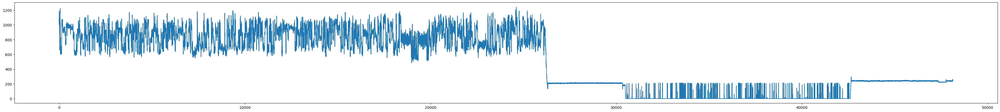

In [17]:
data = f[f'{list(f.keys())[4]}/Raw/Signal'][:]
print(data)
fig = plt.figure(figsize=(len(data)/1000, 5))
plt.plot(data)

In [18]:
bf = pysam.AlignmentFile('calls.bam', 'rb',check_sq=False)
for r in bf:
    print(r.query_name,r.query_sequence)
    print(r.query_alignment_end,r.query_qualities)

02b90fae-b414-4985-8a7c-9358ae0a4b7a TATGTTGTGGTTACTTGGTTCAGTTGTGAAGCCACAATCTATTTCCAACCGTTTCGGCATTTAATACGTGAAGCGCTTTTTTCGCATTTTTGCAATGTTATGTACTTGGTTCAACTTTAAAGCCAATAATTGTTTTAACCGTTTCGCGTTTATCACGTGAAACGCTTGCACGTTTTTCATGCGCCGCTTCACTAGAGCTAACAATAATTTTAAGCAGAGGGCAAAATTATTAATTATAATGACACATCCTACCTGGTCCTTCCATTGCTGAATTTTATCAACTTGGCTGATTTATTTATTATTATTCTCTGACTACCTGTTTCTCCCTCCTATCGATCTTCGAGTTTGTAACGTAAAATGAAACTCACAACCACTATTTGAATCCAGCAGACATATTGACTGAGCCCCACAATATGCAAGGCACCTCTCGGTGCCTAAAGCTAGATCAAGATTAACAAACAGAGAACTATCCTGCTTTTCAGGAAGCCACATGCTACAGAAAACAGAAATAACAACCCAGTGGATCTGGGCTGGAGGTGTCAACTGGCCGGCACAGTCGCTCACACCTGTCATCCCAGCACTTTGGGACTGAGGCAGGTGATCAGCCTGAGTCAGAAGCTCCAGACCAGCCTGGAATATATGGCAAACCCTGTCTGTTAATAAAAATTACAAAGTTAGCTCAGTGTCTGGTGGCTGGGTGCCTGTAATCCCAGCTACTTTGGGAGGCTGAGGCAGAATCGCTTGAACCTGGTCCCAGGGTGGAGTGAGAAGCTGAAGTGAGCCGCCAAGATCATGCCACTACACTCCAGCCTGGTACAACAGAGTGAGTGAAACCCGTCTCAAACAAAACAAAACAAAACAAAAAAAAACAAAAAAAAAAGAAAAAGAAAAAGAATGTGGCAACAGCGCCTCCTCATGACTGACTTAACAAAAGGGAGGTCCTTGGAAGATGGTTAAGAACAA

4b3ab9aa-bb5f-4783-aabc-f8e3ddeb81f2 ATTTCTCTACTTCCTTCCCCTTAAGGACAGCTTGCACCCCTTTCCCTTTCTCCTCACTGCTCCTTTCCTGCTTTCCCTATCCTCCTTTAGCTGTTAGTCCTTCCTTTTTTTGTTTTTCTTTTATTTTGTTTTCCTCTTTCTCTACACCCTTCCTGCCTGTGCTGCTCTCTTCCTTCCTTGCCTGTCTCCCCTACTCCCTCCTCCTGTACTCCTCTGCTCCTGCTCCTCCTGCCTGCTAGCTCCTCTATTTTCCTAGCACCTCCCTCTCCTCCCTTTCCTCTGGCTCCTAGCCTAACTCACTGCCCACTTCTTCCCTGCTAAGTTCCCTAAGCCTTGTCTAGCCCTGGTTTAACTTCCCTCCTTCTTTCTTCCCTTCCTGTAACTGCTTCCTCCTAGTCCTGGTCCCTGTTGGCTAGTCCCTCACCTCTATAGTCCTGCTAACTTCCCTAGGCCCAGGCTGCTTGCACCCTGTACTTTTCCTAAGCCCTGCTTCCCTTTCAGCCAGTCTCTATTTTAGTTCCTTTTTTCCATGTCCTGGCACTGCACTGTTATCACAGTCTCCTAGTTTTTCTTCTCTACTTCACCTGCATCTATTCACAGTTTTTCTAGCCTTTAAGAGTTTATTCCTTCCACTGTTGTAAGCTTCTAAGCTGTTTTAGCTTCCTTTCCCTCACTGTCCTCTATCCTGCCCTGTTGCCCTGTATGCTCTAGTTTAGCCTCCTTCACTGCCCTCCCTCTTCTGCCTCCTGCCTCCTCTCCTTGCCCTCCCTATTTCCTCTTCCTTGTCCTGTTCTGCTCTCTCCTAGGTAGGTTACATGCTACTACTCCTATCCCTTTGCCTAGTTTCACTGTCCTTCTCCCTGCACTGCACTGCCCTTGCACTGTTTGCTCCTAGGCTGCATCCTCTTGTTCCTCCCTGTCCTCCTTCTCCTAGCCTTTGTAGGTCCCTGCCCTAGCTGCCTG